In [17]:
import numpy as np
import soundfile as sf
import scipy.signal as ss
import matplotlib.pyplot as plt
import IPython.display as ipd
from tqdm.notebook import tqdm
from ssspy.bss.ilrma import GGDILRMA as GGDILRMABase
import librosa  # for resampling if needed

# =============================================================================
# Parameters
# =============================================================================
skip_last_sec = 6          # Skip the final 6 seconds of the file
segment_duration_sec = 14  # Extract 14 seconds immediately before the skipped part
n_fft, hop_length = 4096, 2048
target_sr = None  # Set to an integer (e.g., 16000) to downsample; leave as None to keep original

# =============================================================================
# Function: load_and_convert_to_mono
#
# This function loads an audio file, then extracts the segment from:
#    start = (total_duration - (segment_duration_sec + skip_last_sec))
#    end   = (total_duration - skip_last_sec)
# converting the result to mono (by averaging channels) and optionally downsampling.
# =============================================================================
def load_and_convert_to_mono(filepath, segment_duration_sec, skip_last_sec, target_sr=None):
    waveform, sr = sf.read(filepath)  # waveform shape: (n_samples, n_channels)
    
    # Calculate the cropping indices:
    start_idx = -int(sr * (segment_duration_sec + skip_last_sec))
    end_idx = -int(sr * skip_last_sec) if skip_last_sec > 0 else None
    waveform = waveform[start_idx:end_idx]
    
    # Convert to mono if multi-channel:
    if waveform.ndim > 1 and waveform.shape[1] > 1:
        waveform = np.mean(waveform, axis=1)
    else:
        waveform = waveform.squeeze()
    
    # Downsample if target_sr is provided and lower than the original:
    if target_sr is not None and target_sr < sr:
        waveform = librosa.resample(waveform, orig_sr=sr, target_sr=target_sr)
        sr = target_sr
        
    return waveform, sr

# =============================================================================
# 1. Define file paths for ORTF and instrument recordings
#
# Update these paths to point to your actual audio files.
# =============================================================================
ortf_files = [
    "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_7-ortf1.wav",
    "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_8-ortf2.wav",
    "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_9-ortf3.wav",
    "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_10-ortf4.wav"
]

instrument_files = {
    "basse":  "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_BASSE.wav",
    "percus": "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_PERCU.wav",
    "piano":  "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_PIANO.wav",
    "voix":   "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_VOIX.wav",
    "saxo":   "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_SAXO.wav"
}



In [18]:
# =============================================================================
# 2. Load the files using the cropping function
#    (each file is cropped from L - (segment_duration_sec + skip_last_sec)
#     to L - skip_last_sec, i.e. a 14-second segment)
# =============================================================================

# Load ORTF files (each converted to mono)
ortf_mono = []
for f in ortf_files:
    waveform, sr = load_and_convert_to_mono(f, segment_duration_sec, skip_last_sec, target_sr)
    ortf_mono.append(waveform)
    print(f"Loaded ORTF file {f} with shape: {waveform.shape}")

# Load instrument files (each converted to mono)
instr_mono = []
for name, f in instrument_files.items():
    waveform, sr_inst = load_and_convert_to_mono(f, segment_duration_sec, skip_last_sec, target_sr)
    instr_mono.append(waveform)
    print(f"Loaded instrument '{name}' with shape: {waveform.shape}")

# Assume all files now share the same sample rate (if downsampling was applied)
sample_rate = sr  # (or sr_inst; they should be identical if target_sr is used)



Loaded ORTF file ../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_7-ortf1.wav with shape: (617400,)
Loaded ORTF file ../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_8-ortf2.wav with shape: (617400,)
Loaded ORTF file ../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_9-ortf3.wav with shape: (617400,)
Loaded ORTF file ../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_10-ortf4.wav with shape: (617400,)
Loaded instrument 'basse' with shape: (617400,)
Loaded instrument 'percus' with shape: (617400,)
Loaded instrument 'piano' with shape: (617400,)
Loaded instrument 'voix' with shape: (617400,)
Loaded instrument 'saxo' with shape: (617400,)


In [19]:
# =============================================================================
# 3. Create the 9-channel mixture
#
# Stack the 4 ORTF mono files and the 5 instrument mono files into one matrix.
# The resulting mixture has shape (9, n_samples), where n_samples corresponds to the 14-second segment.
# =============================================================================
all_channels = ortf_mono + instr_mono  # total 9 channels
min_samples = min(ch.shape[0] for ch in all_channels)
all_channels = [ch[:min_samples] for ch in all_channels]
waveform_mix = np.vstack(all_channels)
print(f"Mixture shape: {waveform_mix.shape}")

# Display each channel of the mixture (for verification)
for idx, waveform in enumerate(waveform_mix):
    print(f"Mixture channel {idx + 1}:")
    display(ipd.Audio(waveform, rate=sample_rate))
    print()


Mixture shape: (9, 617400)
Mixture channel 1:



Mixture channel 2:



Mixture channel 3:



Mixture channel 4:



Mixture channel 5:



Mixture channel 6:



Mixture channel 7:



Mixture channel 8:



Mixture channel 9:


In [20]:
# =============================================================================
# 4. Compute the STFT of the mixture
#
# For a mixture with shape (9, n_samples), the STFT produces an array of shape (9, n_freq, n_frames).
# =============================================================================
_, _, spectrogram_mix = ss.stft(
    waveform_mix,
    window="hann",
    nperseg=n_fft,
    noverlap=n_fft - hop_length,
    axis=-1
)


In [21]:
# =============================================================================
# 5. Define the GGDILRMA class with a progress bar
# =============================================================================
class GGDILRMA(GGDILRMABase):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.progress_bar = None

    def __call__(self, *args, n_iter: int = 100, **kwargs):
        self.n_iter = n_iter
        return super().__call__(*args, n_iter=n_iter, **kwargs)

    def update_once(self) -> None:
        if self.progress_bar is None:
            self.progress_bar = tqdm(total=self.n_iter)
        super().update_once()
        self.progress_bar.update(1)



In [22]:
# =============================================================================
# 6. Instantiate and run the ILRMA algorithm
#
# Here we extract 5 sources (corresponding to the instruments) from the 9-channel mixture.
# =============================================================================
ilrma = GGDILRMA(
    n_basis=8,
    beta=1.95,
    spatial_algorithm="IP1",  # or "IP" if preferred
    domain=2,
    partitioning=True,
    normalization=False,      # set to False for numerical stability
    rng=np.random.default_rng(42),
)
print(ilrma)

# Run ILRMA on the spectrogram of the mixture (using 200 iterations)
spectrogram_est = ilrma(spectrogram_mix, n_iter=200)


GGDILRMA(n_basis=8, beta=1.95, spatial_algorithm=IP1, source_algorithm=MM, domain=2, partitioning=True, normalization=False, scale_restoration=True, record_loss=True, reference_id=0)


  0%|          | 0/200 [00:00<?, ?it/s]

In [24]:
# =============================================================================
# 7. Reconstruct the time-domain separated sources using the inverse STFT
#
# Note: Depending on your SciPy version, if 'axis' is not accepted, try using 'time_axis' and 'freq_axis'.
# =============================================================================
_, waveform_est = ss.istft(
    spectrogram_est,
    window="hann",
    nperseg=n_fft,
    noverlap=n_fft - hop_length,
    time_axis=-1, 
    freq_axis=-2
)
# Expected shape of waveform_est: (n_sources, n_samples)


Estimated source 1:


Estimated source 2:


Estimated source 3:


Estimated source 4:


Estimated source 5:


Estimated source 6:


Estimated source 7:


Estimated source 8:


Estimated source 9:


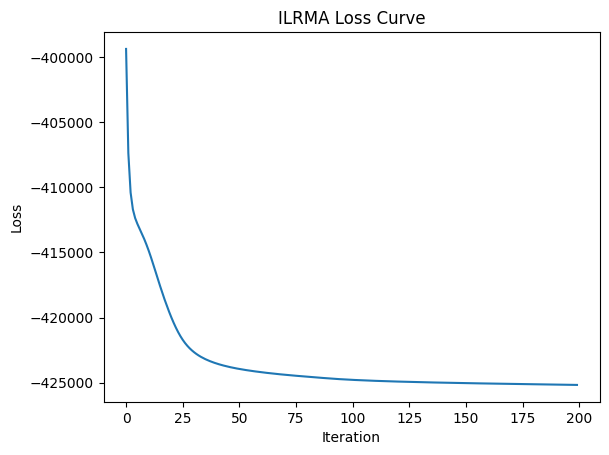

In [25]:
# =============================================================================
# 8. Display and save the separated sources
# =============================================================================
for idx, waveform in enumerate(waveform_est):
    print(f"Estimated source {idx + 1}:")
    display(ipd.Audio(waveform, rate=sample_rate))
    sf.write(f"separated_source{idx + 1}.wav", waveform, sample_rate)

# =============================================================================
# 9. Plot the ILRMA loss curve
# =============================================================================
plt.figure()
plt.plot(ilrma.loss[1:])
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("ILRMA Loss Curve")
plt.show()
plt.close()


In [ ]:
#-----------------------------------------------------------------------------------
#-----------------------------------------------------------------------------------
import numpy as np
import soundfile as sf
import scipy.signal as ss
import matplotlib.pyplot as plt
import IPython.display as ipd
from tqdm.notebook import tqdm
from ssspy.bss.ilrma import GGDILRMA as GGDILRMABase
import librosa  # for resampling if needed

# =============================================================================
# Parameters
# =============================================================================
skip_last_sec = 6          # Skip the final 6 seconds of the file
segment_duration_sec = 14  # Extract a 14-second segment immediately before the final 6 sec
n_fft, hop_length = 4096, 2048
target_sr = None  # Set to an integer (e.g., 16000) to downsample; leave as None to keep original

# =============================================================================
# Function: load_and_convert_to_mono
#
# Loads an audio file, then extracts the segment from:
#    start = (total_duration - (segment_duration_sec + skip_last_sec))
#    end   = (total_duration - skip_last_sec)
# This yields a segment of length segment_duration_sec.
# The function converts the result to mono (by averaging channels) and optionally downsamples.
# =============================================================================
def load_and_convert_to_mono(filepath, segment_duration_sec, skip_last_sec, target_sr=None):
    waveform, sr = sf.read(filepath)  # waveform shape: (n_samples, n_channels)
    
    # Calculate cropping indices:
    start_idx = -int(sr * (segment_duration_sec + skip_last_sec))
    end_idx = -int(sr * skip_last_sec) if skip_last_sec > 0 else None
    waveform = waveform[start_idx:end_idx]
    
    # Convert to mono if multi-channel:
    if waveform.ndim > 1 and waveform.shape[1] > 1:
        waveform = np.mean(waveform, axis=1)
    else:
        waveform = waveform.squeeze()
    
    # Downsample if target_sr is provided and lower than the original:
    if target_sr is not None and target_sr < sr:
        waveform = librosa.resample(waveform, orig_sr=sr, target_sr=target_sr)
        sr = target_sr
        
    return waveform, sr

# =============================================================================
# 1. Define file paths for instrument recordings
#
# Update these paths to point to your actual instrument audio files.
# =============================================================================
instrument_files = {
    "basse":  "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_BASSE.wav",
    "percus": "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_PERCU.wav",
    "piano":  "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_PIANO.wav",
    "voix":   "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_VOIX.wav",
    "saxo":   "../data_PAM/real/Fly_me_v2_indiv/Fly_me_v2_SAXO.wav"
}

# =============================================================================
# 2. Load the instrument files using the cropping function
#
# Each file is cropped from:
#   total_duration - (segment_duration_sec + skip_last_sec)
# to
#   total_duration - skip_last_sec
# (i.e. a 14-second segment immediately before the final 6 seconds).
# =============================================================================
instr_mono = []
for name, f in instrument_files.items():
    waveform, sr_inst = load_and_convert_to_mono(f, segment_duration_sec, skip_last_sec, target_sr)
    instr_mono.append(waveform)
    print(f"Loaded instrument '{name}' with shape: {waveform.shape}")

# Assume all files share the same sample rate (after optional downsampling)
sample_rate = sr_inst

# =============================================================================
# 3. Create the 5-channel mixture
#
# Stack the 5 instrument mono signals into a single matrix.
# The resulting mixture has shape (5, n_samples) corresponding to the 14-second segment.
# =============================================================================
min_samples = min(ch.shape[0] for ch in instr_mono)
instr_mono = [ch[:min_samples] for ch in instr_mono]
waveform_mix = np.vstack(instr_mono)
print(f"Mixture shape: {waveform_mix.shape}")

# Display each channel of the mixture (for verification)
for idx, waveform in enumerate(waveform_mix):
    print(f"Mixture channel {idx + 1}:")
    display(ipd.Audio(waveform, rate=sample_rate))
    print()

# =============================================================================
# 4. Compute the STFT of the mixture
#
# For a mixture with shape (5, n_samples), the STFT produces an array of shape (5, n_freq, n_frames).
# =============================================================================
_, _, spectrogram_mix = ss.stft(
    waveform_mix,
    window="hann",
    nperseg=n_fft,
    noverlap=n_fft - hop_length,
    axis=-1
)

# =============================================================================
# 5. Define the GGDILRMA class (with a progress bar)
# =============================================================================
class GGDILRMA(GGDILRMABase):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.progress_bar = None

    def __call__(self, *args, n_iter: int = 100, **kwargs):
        self.n_iter = n_iter
        return super().__call__(*args, n_iter=n_iter, **kwargs)

    def update_once(self) -> None:
        if self.progress_bar is None:
            self.progress_bar = tqdm(total=self.n_iter)
        super().update_once()
        self.progress_bar.update(1)

# =============================================================================
# 6. Instantiate and run the ILRMA algorithm
#
# We extract 5 sources (one per instrument) from the 5-channel mixture.
# Note: n_basis is set to 30.
# =============================================================================
ilrma = GGDILRMA(
    n_basis=30,                # 30 bases as requested
    beta=1.95,
    spatial_algorithm="IP1",   # or "IP", as needed
    domain=2,
    partitioning=True,
    normalization=False,       # for numerical stability
    rng=np.random.default_rng(42),
)
print(ilrma)

# Run ILRMA on the spectrogram of the mixture using 200 iterations
spectrogram_est = ilrma(spectrogram_mix, n_iter=200)

# =============================================================================
# 7. Reconstruct the time-domain separated sources using ISTFT
#
# Use time_axis=-1 and freq_axis=-2.
# =============================================================================
_, waveform_est = ss.istft(
    spectrogram_est,
    window="hann",
    nperseg=n_fft,
    noverlap=n_fft - hop_length,
    time_axis=-1,
    freq_axis=-2
)
# Expected shape of waveform_est: (n_sources, n_samples)

# =============================================================================
# 8. Display and save the separated sources
# =============================================================================
for idx, waveform in enumerate(waveform_est):
    print(f"Estimated source {idx + 1}:")
    display(ipd.Audio(waveform, rate=sample_rate))
    sf.write(f"separated_source{idx + 1}.wav", waveform, sample_rate)

# =============================================================================
# 9. Plot the ILRMA loss curve
# =============================================================================
plt.figure()
plt.plot(ilrma.loss[1:])
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("ILRMA Loss Curve")
plt.show()
plt.close()


Loaded instrument 'basse' with shape: (617400,)
Loaded instrument 'percus' with shape: (617400,)
Loaded instrument 'piano' with shape: (617400,)
Loaded instrument 'voix' with shape: (617400,)
Loaded instrument 'saxo' with shape: (617400,)
Mixture shape: (5, 617400)
Mixture channel 1:



Mixture channel 2:



Mixture channel 3:



Mixture channel 4:



Mixture channel 5:



GGDILRMA(n_basis=30, beta=1.95, spatial_algorithm=IP1, source_algorithm=MM, domain=2, partitioning=True, normalization=False, scale_restoration=True, record_loss=True, reference_id=0)


  0%|          | 0/200 [00:00<?, ?it/s]